<a href="https://colab.research.google.com/github/aarsh121/terrorism_around_the_world/blob/main/Terrorism_Around_The_World.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Terrorist Activities Around The World.

Data downloaded from Kaggle-
https://www.kaggle.com/datasets/START-UMD/gtd/data

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import matplotlib.patches as mpatches
plt.style.use('fivethirtyeight')
import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.tools as tls
#from mpl_toolkits.basemap import Basemap
import folium
import folium.plugins
from matplotlib import animation,rc
import io
import base64
from IPython.display import HTML, display
import warnings
warnings.filterwarnings('ignore')
#from scipy.misc import imread
import codecs



In [ ]:
df=pd.read_csv('/content/globalterrorismdb_0718dist.csv',encoding='ISO-8859-1')

In [ ]:
df.shape

(181691, 115)

In [ ]:
df.rename(columns={'iyear': 'Year', 'imonth': 'Month', 'iday':'Day', 'country_txt':'Country','region_txt':'Region',
           'attacktype1_txt':'Attacktype','target_txt':'Target','nkill':'Killed', 'nwound':'Wound','gname':'Group',
                   'targtype1_txt':'Target_type','weaptype1_txt':'Weapon_type', 'motive':'Motive','summary':'Summary'},inplace=True)


In [ ]:
df.head()

,Year,Month,Day,resolution,country,Country,region,Region,provstate,city,...,propcomment,ishostkid,nhostkid,nhostkidus,nhours,ndays,divert,kidhijcountry,ransom,casualities
0,1970,7,2,NaN,58,Dominican Republic,2,Central America & Caribbean,NaN,Santo Domingo,...,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.0,1.0
1,1970,0,0,NaN,130,Mexico,1,North America,Federal,Mexico city,...,NaN,1.0,1.0,0.0,NaN,NaN,NaN,Mexico,1.0,0.0
2,1970,1,0,NaN,160,Philippines,5,Southeast Asia,Tarlac,Unknown,...,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.0,1.0
3,1970,1,0,NaN,78,Greece,8,Western Europe,Attica,Athens,...,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN
4,1970,1,0,NaN,101,Japan,4,East Asia,Fukouka,Fukouka,...,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN


In [ ]:
df['casualities']=df['Killed']+df['Wound']

In [ ]:
df.drop(columns={'ransomamt',	'ransomamtus',	'ransompaid',	'ransompaidus'	,'ransomnote'	,'hostkidoutcome'	,'hostkidoutcome_txt',
                 'nreleased',	'addnotes'} ,inplace=True)

In [ ]:
df.isnull().sum()

Year                  0
Month                 0
Day                   0
resolution       179471
country               0
                  ...  
ndays            173567
divert           181367
kidhijcountry    178386
ransom           104310
casualities       16874
Length: 115, dtype: int64

In [ ]:
print('country with highest terrorist attacks:', df['Country'].value_counts().index[0])
print('regions with highest terrorist attackes:', df['Region'].value_counts().index[0])
print('Maximum people killed in an attack:', df['Killed'].max(), 'the country was:', df.loc[df['Killed'].idxmax()].Country)

country with highest terrorist attacks: Iraq
regions with highest terrorist attackes: Middle East & North Africa
Maximum people killed in an attack: 1570.0 the country was: Iraq


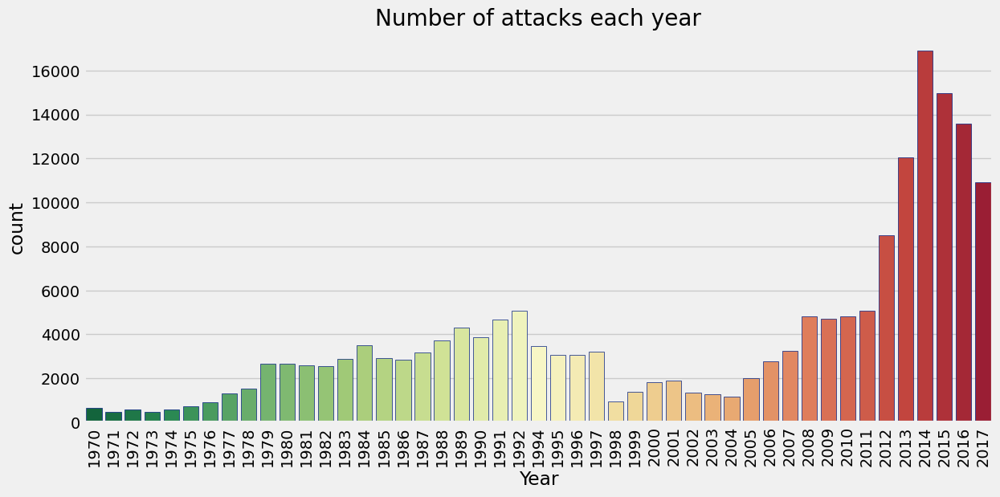

In [ ]:
plt.subplots(figsize=(13,6))
sns.countplot(x='Year',data=df, palette='RdYlGn_r',edgecolor=sns.color_palette('dark',7))
plt.xticks(rotation=90)
plt.title('Number of attacks each year')
plt.show()


Clearly the number of terrorist activities have gone up sharply after 2004
.

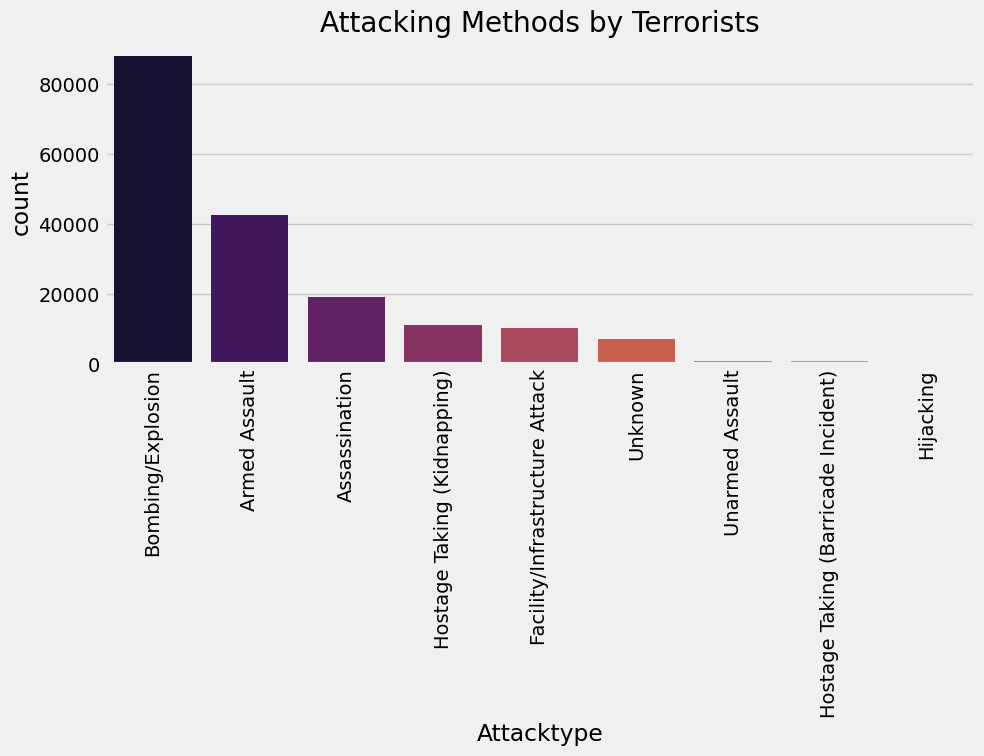

In [ ]:
plt.subplots(figsize=(10,4))
sns.countplot(x='Attacktype', data=df, palette='inferno', order=df['Attacktype'].value_counts().index)
plt.xticks(rotation=90)
plt.title('Attacking Methods by Terrorists')
plt.show()

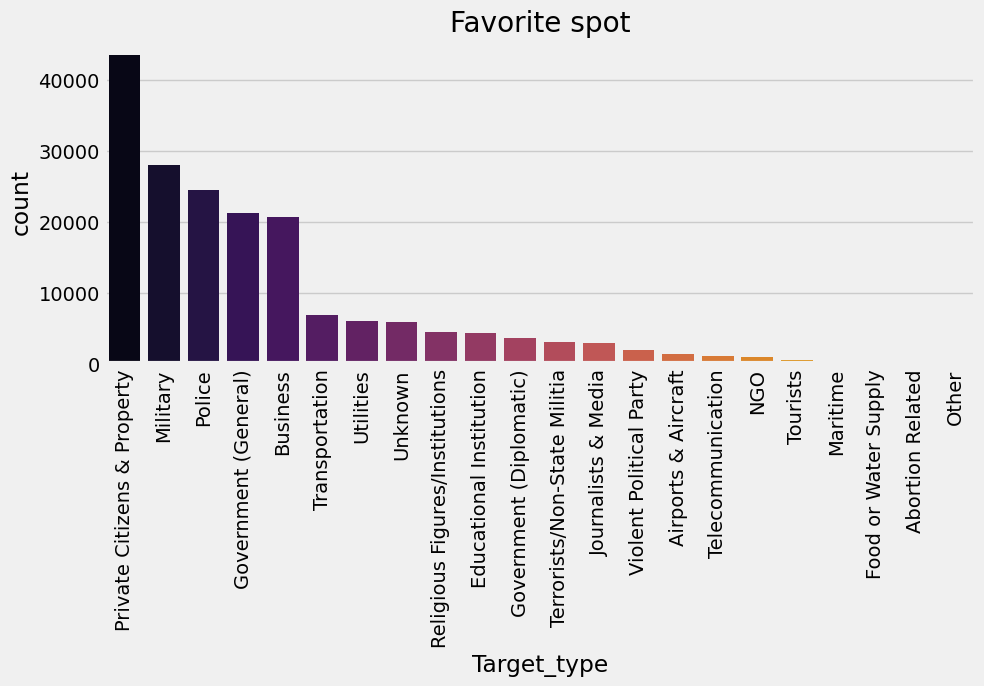

In [ ]:
plt.subplots(figsize=(10,4))
sns.countplot(x='Target_type', data=df, palette='inferno', order=df['Target_type'].value_counts().index)
plt.xticks(rotation=90)
plt.title('Favorite spot')
plt.show()

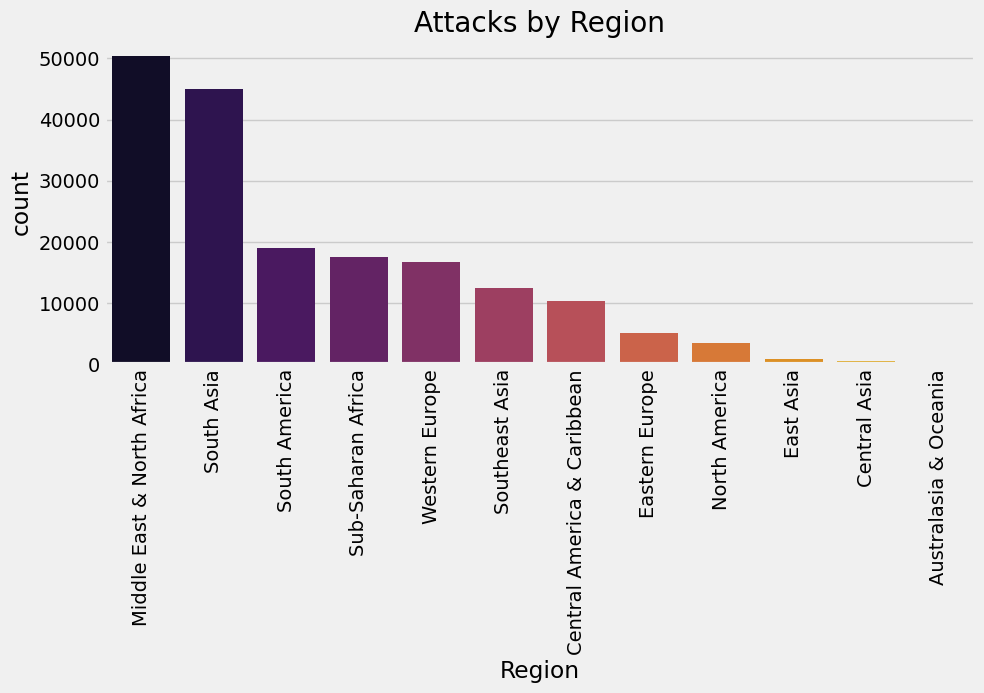

In [ ]:
plt.subplots(figsize=(10,4))
sns.countplot(x='Region', data=df, palette='inferno', order=df['Region'].value_counts().index)
plt.xticks(rotation=90)
plt.title('Attacks by Region')
plt.show()

Middle East and North Africa are the most terrorism prone regions followed by South Asia. The Australian Region have experienced very few terrorist events. Collectively we can say that The African and Asian Continent experience the highest terrorist attacks. But why are these regions prone to terrorism? Does this have any relation to the mindset of the people? or any other reason??

In [ ]:
df.longitude.isnull().sum()

4557

In [ ]:
dffol=df.copy()
dffol.dropna(subset=['latitude','longitude'], inplace=True)


In [ ]:
locfol=dffol[['latitude','longitude']][:5000]
locfol

In [ ]:
countryfol=dffol['Country'][:5000]

In [ ]:
cityfol=dffol['city'][:5000]
killedfol=dffol['Killed'][:5000]
woundfol=dffol['Wound'][:5000]

In [ ]:
def color_point(x):
  if x>30:
    color='red'
  elif (x>0 and x<30):
    color='blue'
  else:
    color='green'
  return color

def point_size(x):
  if(x>30 and x<100):
    size=2
  elif (x>100 and x<500):
    size=8
  elif x>500:
    size=16
  else:
    size=.5
  return size

map2=folium.Map(location=[30,0], tiles='CartoDB dark_matter', zoom_start=2)

for point in locfol.index:
  info='<b>Country: <b>'+ str(countryfol[point])+'<br><b>City: <b>' +str(cityfol[point])+'<br><b>Killed: <b>'+str(killedfol[point])+'<br><b>Wounded: <b>'+str(woundfol[point])
  iframe=folium.IFrame(html=info, width=200, height=200)
  folium.CircleMarker(list(locfol.loc[point].values), popup=folium.Popup(iframe),
                radius=point_size(killedfol[point]), color=color_point(killedfol[point])).add_to(map2)

In [ ]:
map2

Trend in Terrorist Activities

In [ ]:
terror_region=pd.crosstab(df.Year, df.Region)
terror_region.head()

Region,Australasia & Oceania,Central America & Caribbean,Central Asia,East Asia,Eastern Europe,Middle East & North Africa,North America,South America,South Asia,Southeast Asia,Sub-Saharan Africa,Western Europe
Year,,,,,,,,,,,,
1970,1,7,0,2,12,28,472,65,1,10,3,50
1971,1,5,0,1,5,55,247,24,0,6,2,125
1972,8,3,0,0,1,53,73,33,1,16,4,376
1973,1,6,0,2,1,19,64,83,1,2,4,290
1974,1,11,0,4,2,42,111,81,2,3,7,317


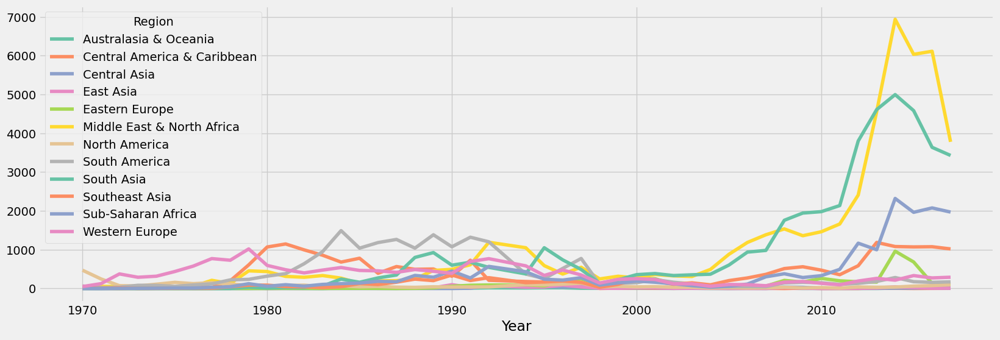

In [ ]:
terror_region.plot(color=sns.color_palette('Set2', 12))
fig=plt.gcf()
fig.set_size_inches(18,6)
plt.show()

As seen already, Middle-East,North Africa,South Asia have seen a shoot in the number of terrorist activities over the years.


AttackType vs Region

In [ ]:
terror_attack=pd.crosstab(df.Region, df.Attacktype)
terror_attack

Attacktype,Armed Assault,Assassination,Bombing/Explosion,Facility/Infrastructure Attack,Hijacking,Hostage Taking (Barricade Incident),Hostage Taking (Kidnapping),Unarmed Assault,Unknown
Region,,,,,,,,,
Australasia & Oceania,51,36,75,71,3,6,13,11,16
Central America & Caribbean,4361,1254,3239,403,26,187,501,19,354
Central Asia,116,115,235,20,8,2,45,5,17
East Asia,117,55,330,200,18,3,14,42,23
Eastern Europe,1274,400,2766,260,26,21,220,62,115
Middle East & North Africa,9273,4206,30908,1115,138,100,2666,177,1891
North America,448,255,1534,906,18,67,123,73,32
South America,3875,2745,9039,803,67,234,1414,47,754
South Asia,11404,4301,21246,2189,93,120,3277,323,2021


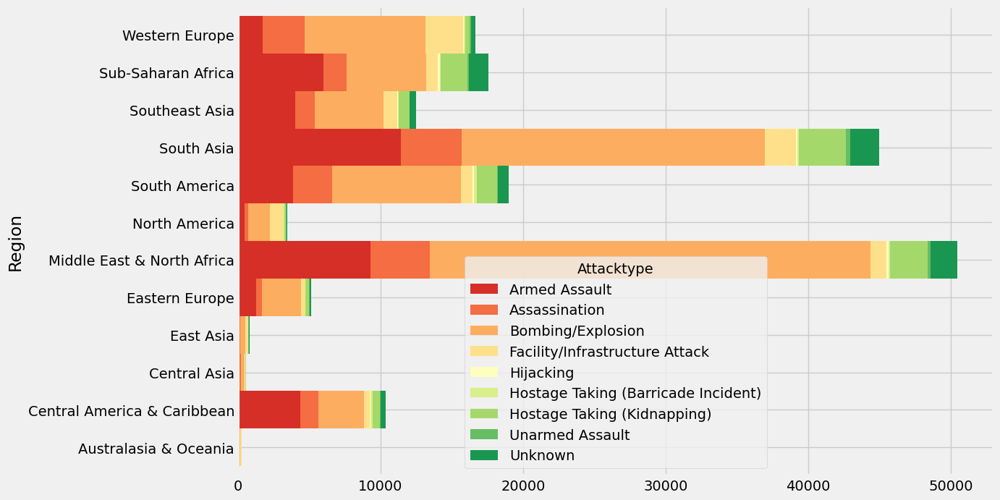

In [ ]:
terror_attack.plot.barh(stacked=True,width=1,color=sns.color_palette('RdYlGn',9))
fig=plt.gcf()
fig.set_size_inches(12,8)
plt.show()

Bombing and Armed assaults, as seen above are the most prominent types of Attack irrespective of Regions.

Terrorism by country


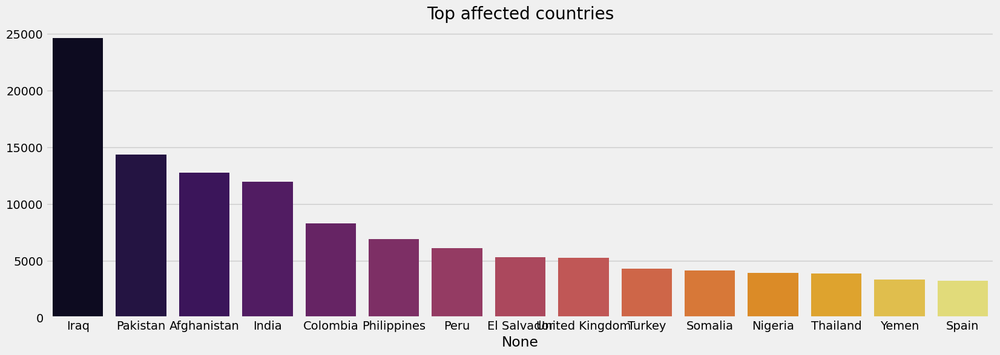

In [ ]:
plt.subplots(figsize=(18,6))
sns.barplot(x=df['Country'].value_counts()[:15].index, y=df['Country'].value_counts()[:15].values, palette='inferno')
plt.title('Top affected countries')
plt.show()

Iraq has witnessed a very large number of terrorist activities followed by Pakistan. One thing to note is the countries with highest attacks, are mostly densely populated countries, thus it will eventually claim many lives. Let's check

Attack vs Killed

In [ ]:
coun_terror=df['Country'].value_counts()[:15].to_frame()
coun_terror

,Country
Iraq,24636
Pakistan,14368
Afghanistan,12731
India,11960
Colombia,8306
Philippines,6908
Peru,6096
El Salvador,5320
United Kingdom,5235
Turkey,4292


In [ ]:
#coun_terror.columns=['Attack']
#coun_terror
coun_kill=df.groupby('Country')['Killed'].sum().to_frame()
coun_kill

,Killed
Country,
Afghanistan,39384.0
Albania,42.0
Algeria,11066.0
Andorra,0.0
Angola,3043.0
...,...
Yemen,8776.0
Yugoslavia,119.0
Zaire,324.0


In [ ]:
coun_merge=coun_terror.merge(coun_kill, left_index=True, right_index=True, how='left')
coun_merge

,Attack,Killed
Iraq,24636,78589.0
Pakistan,14368,23822.0
Afghanistan,12731,39384.0
India,11960,19341.0
Colombia,8306,14698.0
Philippines,6908,9559.0
Peru,6096,12771.0
El Salvador,5320,12053.0
United Kingdom,5235,3410.0
Turkey,4292,6888.0


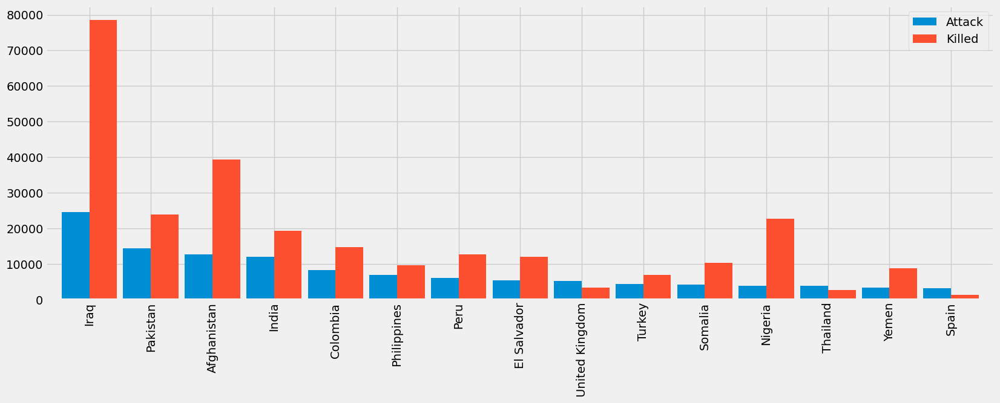

In [ ]:
coun_merge.plot.bar(width=0.9)
fig=plt.gcf()
fig.set_size_inches(18,6)
plt.show()

Damn!! Look at the killed bar for Iraq. The number of killed is almost 3 folds more than attacks for Iraq. Thus the densely populated theory holds good.

Most Notororius groups

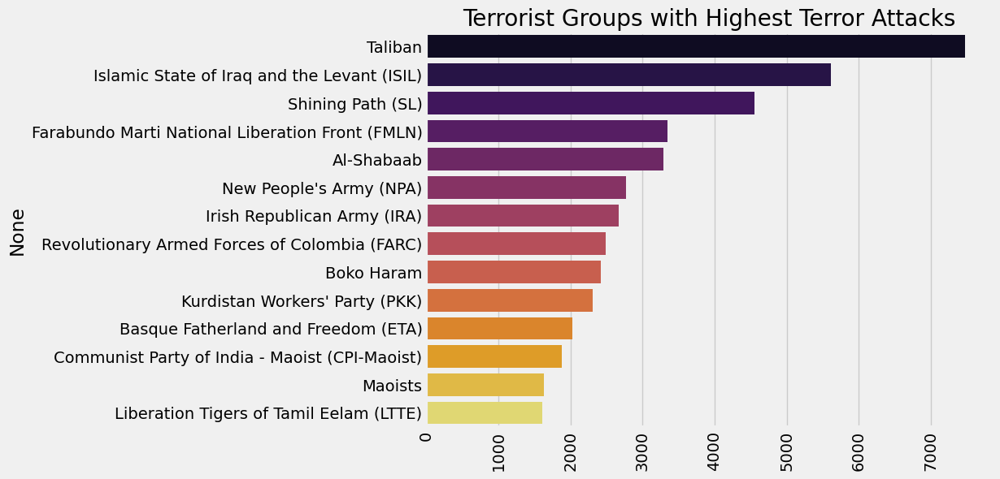

In [ ]:
sns.barplot(y=df['Group'].value_counts()[1:15].index, x=df['Group'].value_counts()[1:15].values,palette=('inferno') )
plt.title('Terrorist Groups with Highest Terror Attacks')
plt.xticks(rotation=90)
fig=plt.gcf()
fig.set_size_inches(8,6)
plt.title('Terrorist Groups with Highest Terror Attacks')
plt.show()

Activity of Top Terrorist Groups

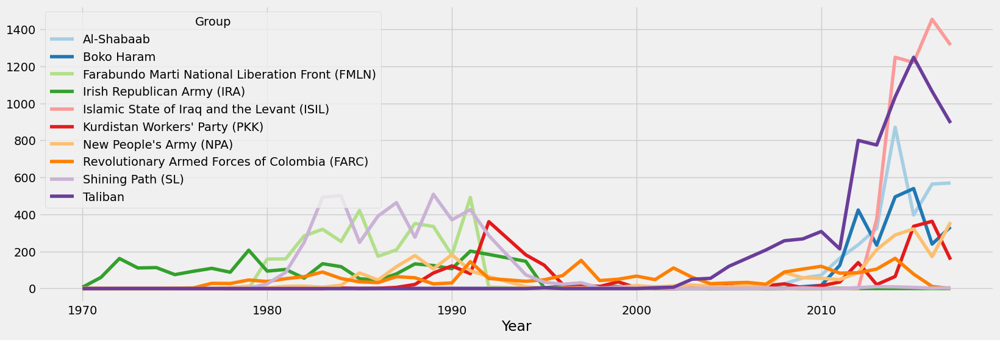

In [ ]:
top_grp10=df[df['Group'].isin(df['Group'].value_counts()[1:11].index)]
top=pd.crosstab(top_grp10.Year, top_grp10.Group)
top.plot(color=sns.color_palette('Paired',10))
fig=plt.gcf()
fig.set_size_inches(18,6)
plt.show()

The Irish Republican Army(IRA), is the oldest terrorist group started back in the 1960-1970, maybe after the World War 2 due to the mass killing. However, it has probably stopped its activities in the late 90's. Some of the groups that have started lately in 2000's like the ISIL and Taliban, have shown a shoot in the number of attacks in the past years.

Terror Activities in India

In [ ]:
terror_india=df[df['Country']=='India']
terror_india

,Year,Month,Day,resolution,country,Country,region,Region,provstate,city,...,propcomment,ishostkid,nhostkid,nhostkidus,nhours,ndays,divert,kidhijcountry,ransom,casualities
1186,1972,2,22,NaN,92,India,6,South Asia,Delhi,New Delhi,...,NaN,1.0,187.0,0.0,NaN,NaN,Yemen,Yemen,1.0,0.0
2764,1975,1,2,NaN,92,India,6,South Asia,Bihar,Samastipur,...,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.0
3857,1976,5,26,NaN,92,India,6,South Asia,Delhi,New Delhi,...,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0
5327,1977,9,28,NaN,92,India,6,South Asia,Maharashtra,Bombay,...,NaN,1.0,146.0,9.0,NaN,NaN,Algeria,Algeria,1.0,0.0
7337,1979,1,13,NaN,92,India,6,South Asia,Assam,Unknown,...,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
181663,2017,12,30,NaN,92,India,6,South Asia,Kerala,Koothuparamba,...,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
181665,2017,12,30,NaN,92,India,6,South Asia,Chhattisgarh,Toylanka,...,Several construction vehicles were damaged in ...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
181672,2017,12,31,NaN,92,India,6,South Asia,Jammu and Kashmir,Lethapora,...,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,11.0
181684,2017,12,31,NaN,92,India,6,South Asia,Assam,Hungrum,...,NaN,1.0,1.0,0.0,14.0,NaN,NaN,NaN,0.0,0.0


In [ ]:
tefol=terror_india.copy()
tefol.dropna(subset={'latitude','longitude'}, inplace=True)
loc_ind=tefol[['latitude','longitude']][:5000]
city_ind=tefol['city'][:5000]
killed_ind=tefol['Killed'][:5000]
wound_ind=tefol['Wound'][:5000:]
target_ind=tefol['Target_type'][:5000]

map4=folium.Map(location=[30,0], tiles='CartoDB dark_matter',zoom_start=4.5)

for point in loc_ind.index:
  folium.CircleMarker(list(loc_ind.loc[point].values),popup='<b>City: </b>'+str(city_ind[point])+
                      '<br><b>Killed: </b>'+str(killed_ind[point])+\
                        '<br><b>Injured: </b>'+str(wound_ind[point])+'<br><b>Target: </b>'+str(target_ind[point]),
                      radius=point_size(killed_ind[point]),color=color_point(killed_ind[point]),fill_color=color_point(killed_ind[point])).add_to(map4)
map4

Most Notorious Groups in India and Favorite Attack Types

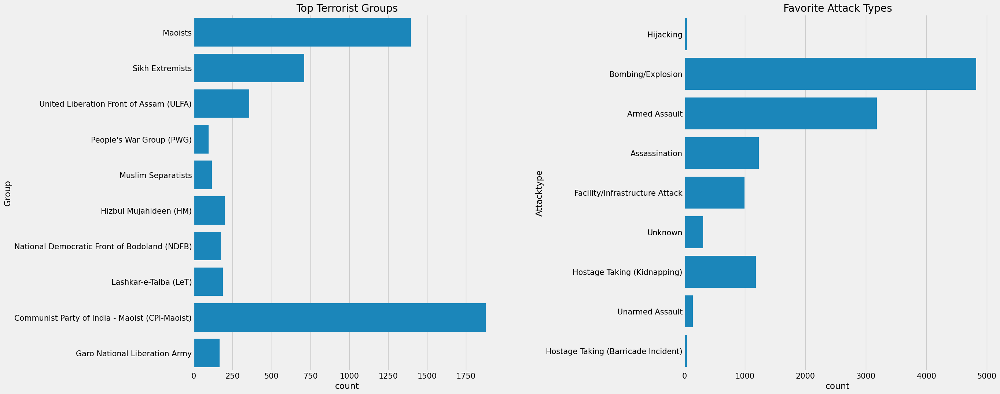

In [ ]:
f,ax=plt.subplots(1,2,figsize=(25,12))
ind_groups=terror_india['Group'].value_counts()[1:11].index
ind_groups=terror_india[terror_india['Group'].isin(ind_groups)]
sns.countplot(y='Group',data=ind_groups,ax=ax[0])
ax[0].set_title('Top Terrorist Groups')
sns.countplot(y='Attacktype',data=terror_india,ax=ax[1])
ax[1].set_title('Favorite Attack Types')
plt.subplots_adjust(hspace=0.3,wspace=0.6)
ax[0].tick_params(labelsize=15)
ax[1].tick_params(labelsize=15)
plt.show()

In [ ]:
terror_usa=df[df['Country']=='United States']
terror_usa_fol=terror_usa.copy()
terror_usa_fol.dropna(subset=['latitude','longitude'],inplace=True)
location_usa=terror_usa_fol[['latitude','longitude']]
city_usa=terror_usa_fol['city']
killed_usa=terror_usa_fol['Killed']
wound_usa=terror_usa_fol['Wound']
target_usa=terror_usa_fol['Target_type']

map5 = folium.Map(location=[39.50, -98.35],tiles='CartoDB dark_matter',zoom_start=3.5)
for point in location_usa.index:
    info='<b>City:</b>'+str(city_usa[point])+'<br><b>Killed</b>: '+str(killed_usa[point])+'<br><b>Wounded</b>: '+str(wound_usa[point])+'<br><b>Target</b>: '+str(target_usa[point])
    iframe = folium.IFrame(html=info, width=200, height=200)
    folium.CircleMarker(list(location_usa.loc[point].values),popup=folium.Popup(iframe),radius=point_size(killed_usa[point]),color=color_point(killed_usa[point])).add_to(map5)

map5

Most Notorious Groups in USA and Favorite Attack Type

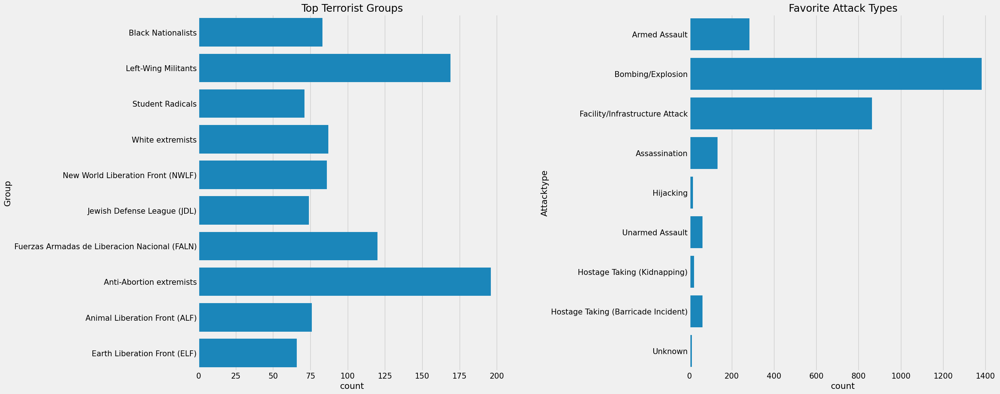

In [ ]:
f,ax=plt.subplots(1,2,figsize=(25,12))
usa_groups=terror_usa['Group'].value_counts()[1:11].index
usa_groups=terror_usa[terror_usa['Group'].isin(usa_groups)]
sns.countplot(y='Group',data=usa_groups,ax=ax[0])
sns.countplot(y='Attacktype',data=terror_usa,ax=ax[1])
plt.subplots_adjust(hspace=0.3,wspace=0.6)
ax[0].set_title('Top Terrorist Groups')
ax[1].set_title('Favorite Attack Types')
ax[0].tick_params(labelsize=15)
ax[1].tick_params(labelsize=15)
plt.show()

USA doesn't witness many terror attacks as compared to India.There are very few attacks that have claimed a very large number of lives. Also the number of casualities on an average is less as compared to that of India.

It has however witnessed one of the worst terrorist attacks in 2001 in New-York, which killed more than 1500 people

Motive behind Attacks

Motive simply means the reason for doing something. Now this reason may be anything, personal grudges, revolt against government, religious sentiments, etc. In this part we will try to analyse what are the main reasons behind the terrorist activities.

For this we will use NLTK for Natural Language Processing. The reason for using NLP is because if we simply take the count of words and make a wordcloud, many useless words like 'the','and,'is', etc will have the highest count as they are very common in english language. Thus using NLTK, we can filter out these words and find other important words.

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


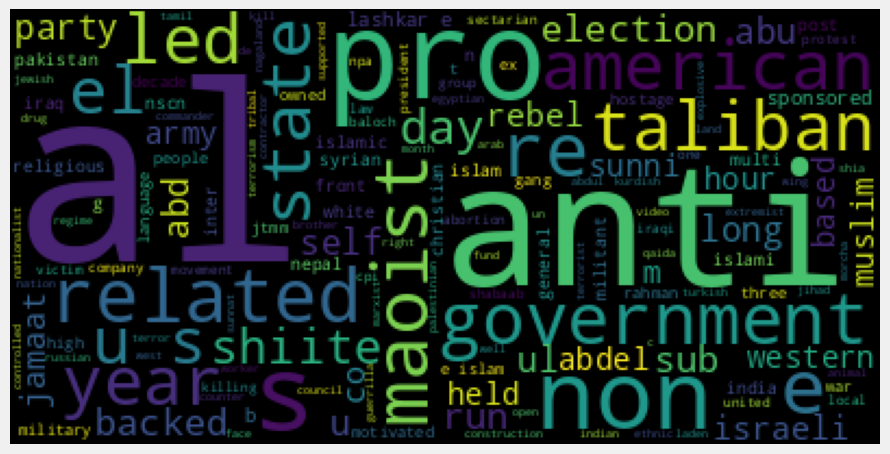

In [ ]:
import nltk
nltk.download('punkt')
nltk.download('stopwords')
from wordcloud import WordCloud, STOPWORDS
motive=df['Motive'].str.lower().str.replace(r'\|', ' ').str.cat(sep=' ')
words=nltk.tokenize.word_tokenize(motive)
word_dist = nltk.FreqDist(words)
stopwords = nltk.corpus.stopwords.words('english')
words_except_stop_dist = nltk.FreqDist(w for w in words if w not in stopwords)
wordcloud = WordCloud(stopwords=STOPWORDS,background_color='black').generate(" ".join(words_except_stop_dist))
plt.imshow(wordcloud)
fig=plt.gcf()
fig.set_size_inches(10,6)
plt.axis('off')
plt.show()

Religious sentiments or religion looks to be the main cause of terrorism. Some of the most dangerous terrorist group names like 'al' for al-kaeda looks prominent. Some other words like 'government' and 'anti' also show attacks dur to resentment against the government.